In [41]:
import pandas
import scipy
from scipy.signal import butter, filtfilt
import scipy.io
import pandas as pd
from pathlib import Path
import numpy as np
import re
import mne 
from matplotlib import pyplot as plt
from mne.preprocessing import ICA, corrmap, create_ecg_epochs, create_eog_epochs
from sklearn.cross_decomposition import CCA
import librosa
import warnings

warnings.filterwarnings("ignore", category=RuntimeWarning)
mne.set_log_level("ERROR")


In [2]:
data_path = Path("./resources_lab5")
i = 1
fn = data_path / f"S{i}.mat"

In [3]:
ff = scipy.io.loadmat(data_path / "Freq_Phase.mat")
print(ff)

{'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Tue May 10 15:31:46 2016', '__version__': '1.0', '__globals__': [], 'phases': array([[0.        , 1.57079633, 3.14159265, 4.71238898, 0.        ,
        1.57079633, 3.14159265, 4.71238898, 1.57079633, 3.14159265,
        4.71238898, 0.        , 1.57079633, 3.14159265, 4.71238898,
        0.        , 3.14159265, 4.71238898, 0.        , 1.57079633,
        3.14159265, 4.71238898, 0.        , 1.57079633, 4.71238898,
        0.        , 1.57079633, 3.14159265, 4.71238898, 0.        ,
        1.57079633, 3.14159265, 0.        , 1.57079633, 3.14159265,
        4.71238898, 0.        , 1.57079633, 3.14159265, 4.71238898]]), 'freqs': array([[ 8. ,  9. , 10. , 11. , 12. , 13. , 14. , 15. ,  8.2,  9.2, 10.2,
        11.2, 12.2, 13.2, 14.2, 15.2,  8.4,  9.4, 10.4, 11.4, 12.4, 13.4,
        14.4, 15.4,  8.6,  9.6, 10.6, 11.6, 12.6, 13.6, 14.6, 15.6,  8.8,
         9.8, 10.8, 11.8, 12.8, 13.8, 14.8, 15.8]])}


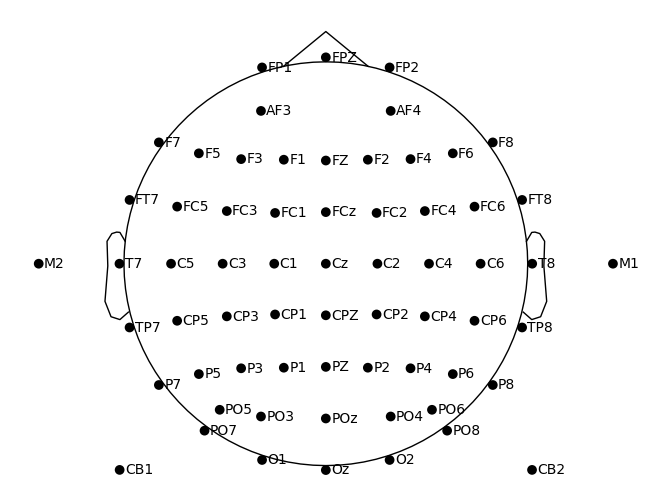

In [4]:
montage = mne.channels.read_custom_montage(data_path / "64-channels.loc")
ch_names = montage.ch_names
montage.plot();

In [5]:
data = scipy.io.loadmat(fn)["data"]
data.shape

(64, 1500, 40, 6)

In [6]:
info = mne.create_info(ch_names=ch_names, sfreq=250, ch_types='eeg')
info.set_montage(montage)
raw = mne.io.RawArray(data[:,:,0,0], info)

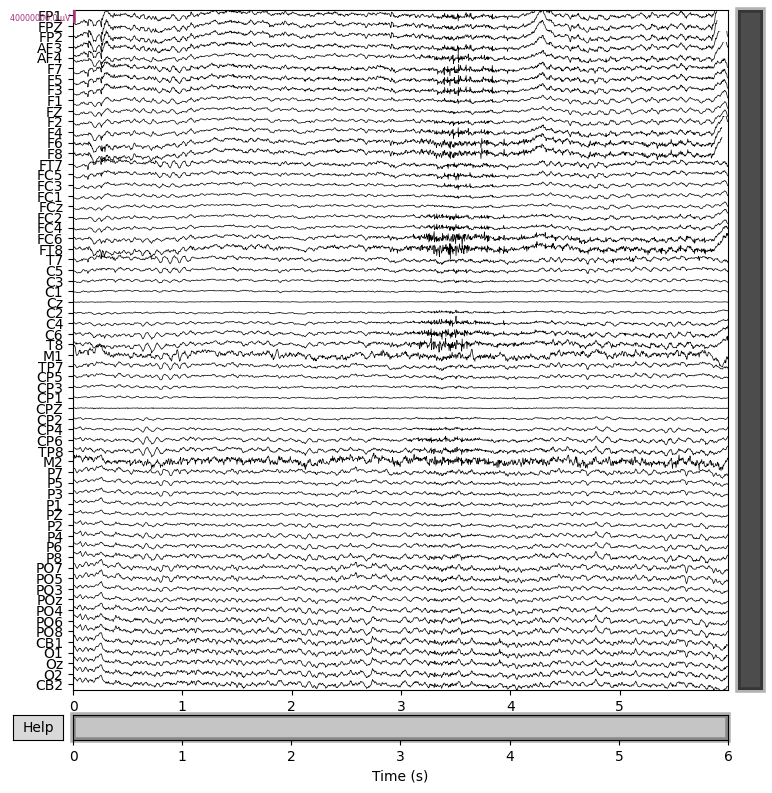

In [7]:
raw.plot(scalings=2e1, duration=1500//250, n_channels=64);

In [8]:
epochs_array = data.reshape(data.shape[0], data.shape[1], data.shape[2]*data.shape[3], order="F")
epochs_array = np.swapaxes(epochs_array, 0,-1)
epochs_array = np.swapaxes(epochs_array, 1,2)
# events = np.c_[(np.arange(240)+125), [0]*240, np.tile((ff['freqs'][0]*10).astype(int), 6)] 

epochs = mne.EpochsArray(epochs_array, info, tmin=0)
epochs

<EpochsArray | 240 events (all good), 0 – 5.996 s (baseline off), ~175.9 MiB, data loaded,
 '1': 240>

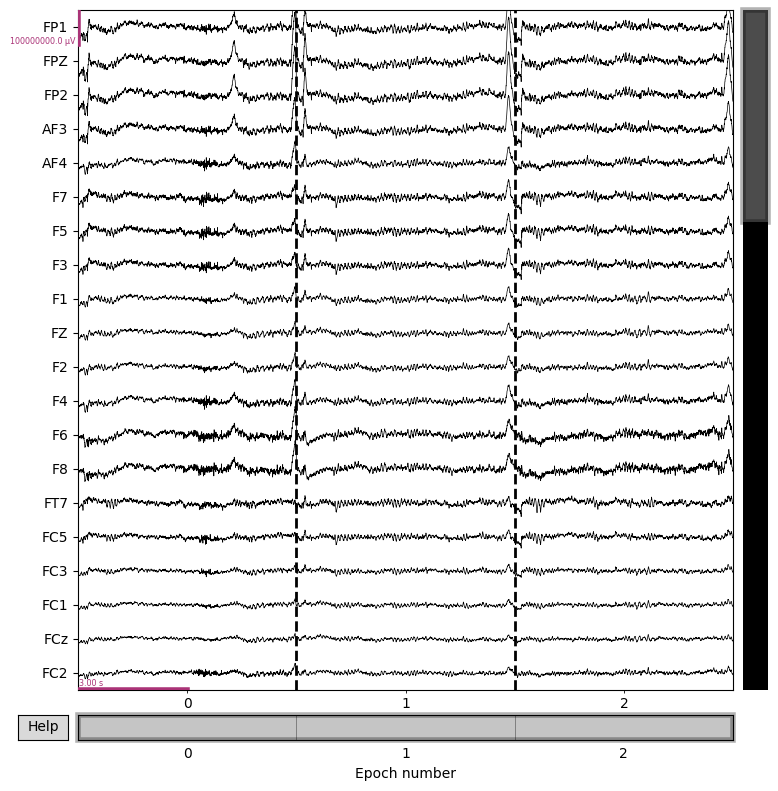

In [9]:
epochs[0:3].plot(scalings=5e1);

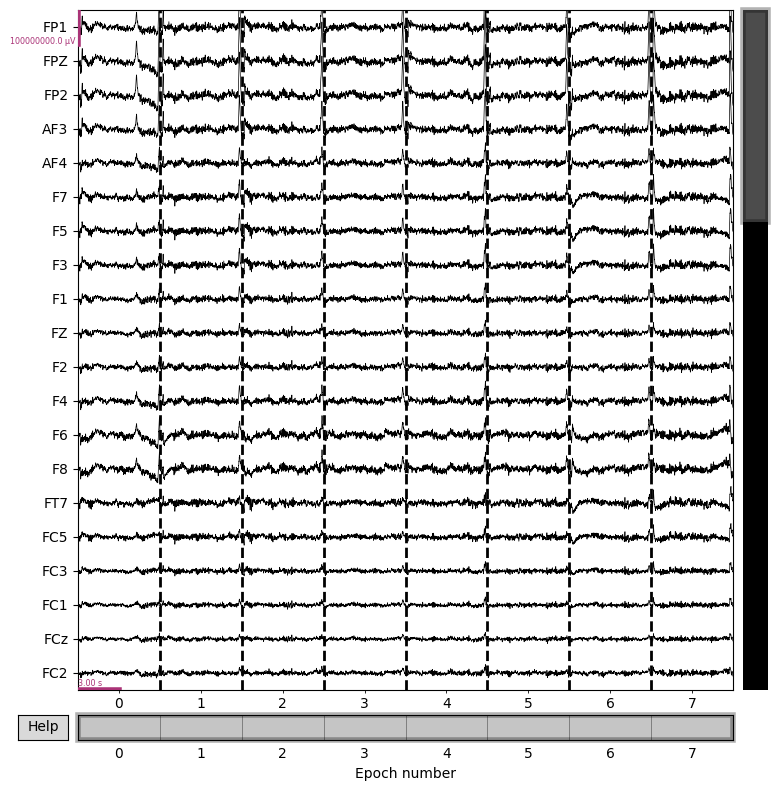

In [10]:
_epochs = epochs.filter(0.5,45)
_epochs[0:8].plot(scalings=5e1);


In [11]:
ica = ICA(n_components=15, max_iter="auto", random_state=97)
ica.fit(epochs)
ica

Method,fastica
Fit parameters,algorithm=parallelfun=logcoshfun_args=Nonemax_iter=1000
Fit,43 iterations on epochs (360000 samples)
ICA components,15
Available PCA components,64
Channel types,eeg
ICA components marked for exclusion,—


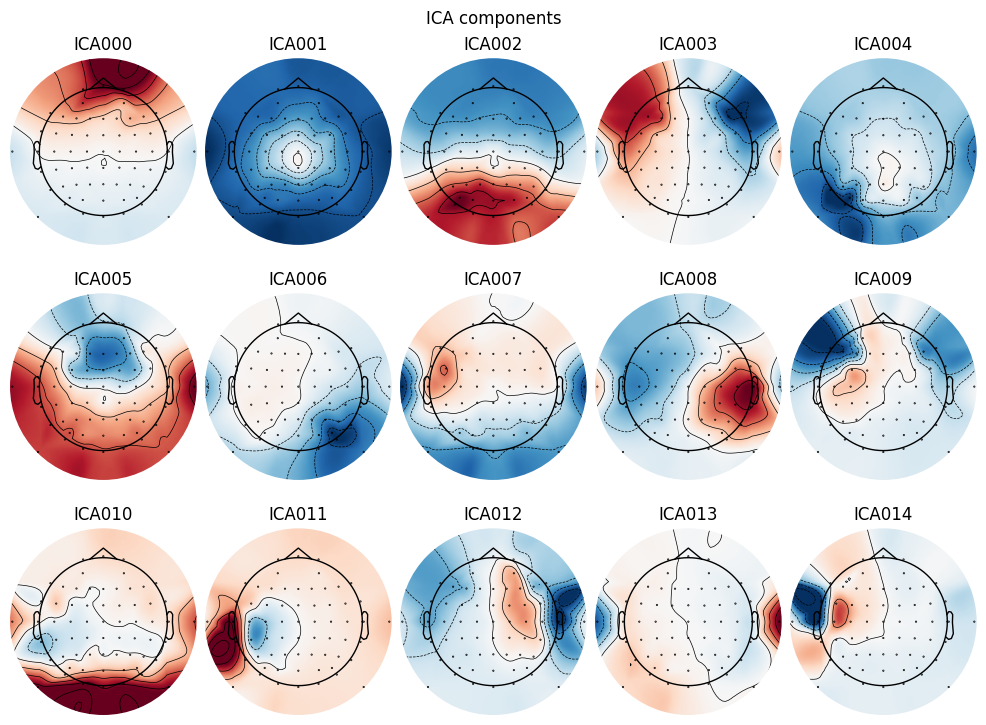

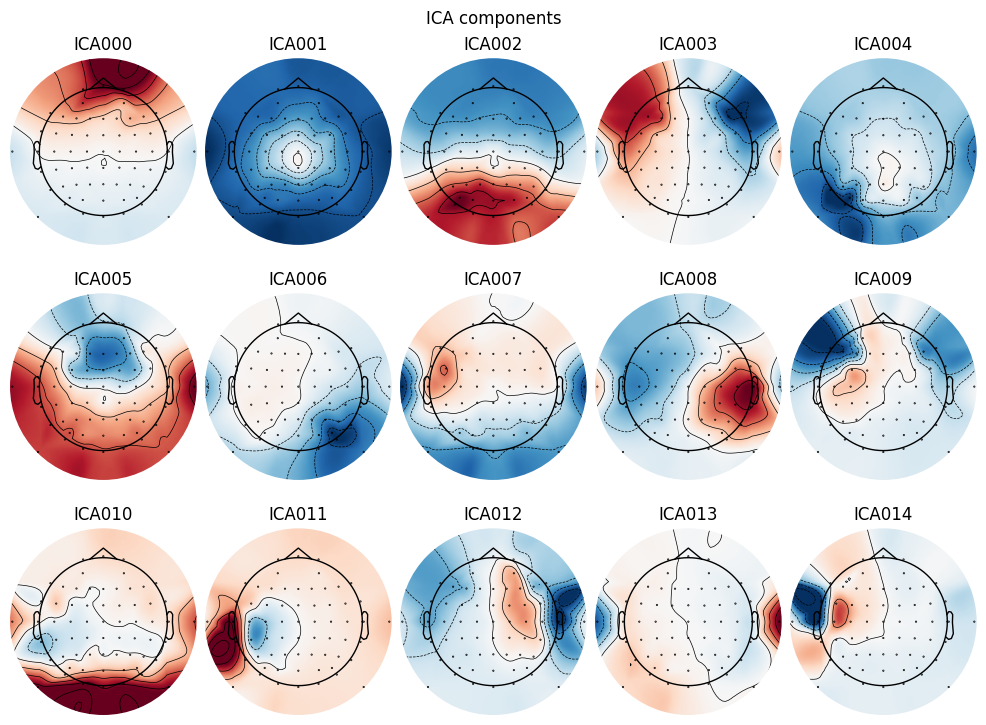

In [12]:
ica.plot_components()

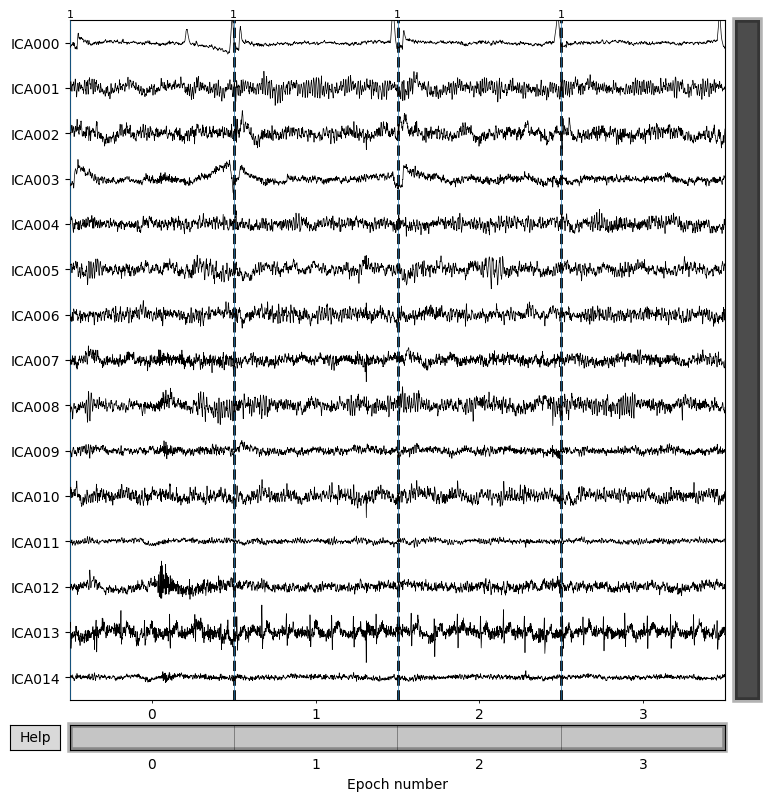

In [13]:
ica.plot_sources(epochs[0:4]);

С помощью ICA удаляем моргания

In [ ]:
# Моргания, похоже, располагаются на первом канале (визуально); удаляем его
ica.exclude = [0]
epochs_clean = ica.apply(epochs.copy())

ICA_removal = True

Subject 1 FFT accuracy (window=0.5s): 0.073
Subject 2 FFT accuracy (window=0.5s): 0.052
Subject 3 FFT accuracy (window=0.5s): 0.062
Subject 4 FFT accuracy (window=0.5s): 0.062
Subject 5 FFT accuracy (window=0.5s): 0.062
Subject 6 FFT accuracy (window=0.5s): 0.062
Subject 7 FFT accuracy (window=0.5s): 0.062
Subject 8 FFT accuracy (window=0.5s): 0.062
Subject 9 FFT accuracy (window=0.5s): 0.062
Subject 10 FFT accuracy (window=0.5s): 0.062
Subject 11 FFT accuracy (window=0.5s): 0.062
Subject 12 FFT accuracy (window=0.5s): 0.062
Subject 13 FFT accuracy (window=0.5s): 0.062
Subject 14 FFT accuracy (window=0.5s): 0.062
Subject 15 FFT accuracy (window=0.5s): 0.062
Subject 16 FFT accuracy (window=0.5s): 0.062
Subject 17 FFT accuracy (window=0.5s): 0.062
Subject 18 FFT accuracy (window=0.5s): 0.062
Subject 19 FFT accuracy (window=0.5s): 0.062
Subject 20 FFT accuracy (window=0.5s): 0.062
Subject 21 FFT accuracy (window=0.5s): 0.062
Subject 22 FFT accuracy (window=0.5s): 0.062
Subject 23 FFT accu

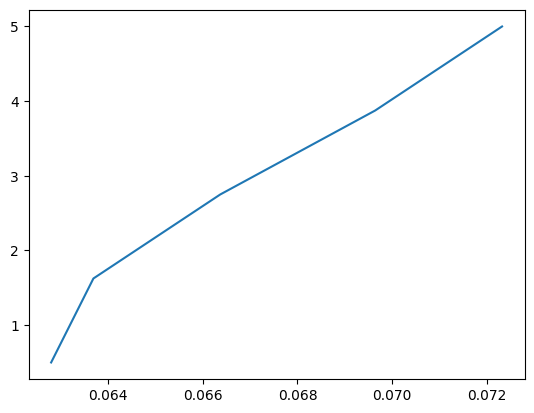

In [ ]:
data_path = Path("./resources_lab5")
ff = scipy.io.loadmat(data_path / "Freq_Phase.mat")
freqs_all = ff.get('freqs').squeeze()
selected_idx = [0,1,2,3,4,5,6,7,16,17,18,19,20,21,22,23]
freqs_selected = freqs_all[selected_idx]
window_size = np.linspace(0.5, 5.0, 5)
sfreq = 250

def fft_subject_file(subject_idx, window_size_s=2.0, ICA_removal=True):
    n_samples = int(window_size_s * sfreq)
    fn = data_path / f"S{subject_idx}.mat"

    montage = mne.channels.read_custom_montage(data_path / "64-channels.loc")
    ch_names = montage.ch_names
    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types="eeg")

    mat = scipy.io.loadmat(fn)
    data = mat["data"]
    epochs_array = data.reshape(data.shape[0], data.shape[1], data.shape[2]*data.shape[3], order="F")
    epochs_array = np.swapaxes(epochs_array, 0, -1)
    epochs_array = np.swapaxes(epochs_array, 1, 2)

    epochs = mne.EpochsArray(epochs_array, info, tmin=0)
    epochs = epochs.filter(0.5, 45, verbose=False)

    if ICA_removal:
        ica = ICA(n_components=15, max_iter="auto", random_state=97)
        ica.fit(epochs)
        ica.exclude = [0]
        epochs = ica.apply(epochs.copy())

    freqs_true_all = np.tile(freqs_all, 6) 
    mask = np.isin(freqs_true_all, freqs_selected)
    epochs = epochs[mask]
    true_freqs = freqs_true_all[mask]

    X = epochs.get_data()
    n_epochs, n_channels, n_times = X.shape

    pred_freqs = []
    for ep in range(n_epochs):
        epoch = X[ep]
        segment = epoch[:, -n_samples:]
        window = np.hamming(n_samples)
        segment = segment * window[np.newaxis, :]

        fft_vals = np.fft.rfft(segment, axis=1)
        fft_freqs = np.fft.rfftfreq(n_samples, 1/sfreq)

        power = np.abs(fft_vals) ** 2
        spec = power.mean(axis=0)

        idx = np.argmax(spec)
        pred_f = fft_freqs[idx]

        nearest_idx = np.argmin(np.abs(freqs_selected - pred_f))
        pred_freqs.append(freqs_selected[nearest_idx])

    pred_freqs = np.array(pred_freqs)
    accuracy = np.mean(pred_freqs == true_freqs)
    print(f"Subject {subject_idx} FFT accuracy (window={window_size_s}s): {accuracy:.3f}")
    return true_freqs, pred_freqs, fft_freqs, spec

a_val = np.array([])
for window in window_size:
    avg_accuracy = np.array([])
    for i in range(1, 36):
        true_f, pred_f, f_axis, example_spec = fft_subject_file(i, window_size_s=window, ICA_removal=True)
        accuracy = np.mean(pred_f == true_f)
        avg_accuracy = np.append(avg_accuracy, accuracy)
    a_val = np.append(a_val, np.mean(avg_accuracy))

plt.plot(a_val, window_size)
plt.show()

ICA_removal = False

Subject 1 FFT accuracy (window=0.5s): 0.062
Subject 2 FFT accuracy (window=0.5s): 0.062
Subject 3 FFT accuracy (window=0.5s): 0.062
Subject 4 FFT accuracy (window=0.5s): 0.062
Subject 5 FFT accuracy (window=0.5s): 0.062
Subject 6 FFT accuracy (window=0.5s): 0.062
Subject 7 FFT accuracy (window=0.5s): 0.062
Subject 8 FFT accuracy (window=0.5s): 0.062
Subject 9 FFT accuracy (window=0.5s): 0.062
Subject 10 FFT accuracy (window=0.5s): 0.062
Subject 11 FFT accuracy (window=0.5s): 0.062
Subject 12 FFT accuracy (window=0.5s): 0.062
Subject 13 FFT accuracy (window=0.5s): 0.062
Subject 14 FFT accuracy (window=0.5s): 0.062
Subject 15 FFT accuracy (window=0.5s): 0.062
Subject 16 FFT accuracy (window=0.5s): 0.062
Subject 17 FFT accuracy (window=0.5s): 0.062
Subject 18 FFT accuracy (window=0.5s): 0.062
Subject 19 FFT accuracy (window=0.5s): 0.062
Subject 20 FFT accuracy (window=0.5s): 0.062
Subject 21 FFT accuracy (window=0.5s): 0.062
Subject 22 FFT accuracy (window=0.5s): 0.062
Subject 23 FFT accu

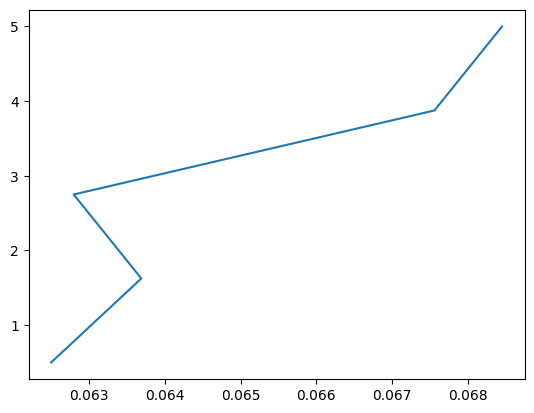

In [ ]:
data_path = Path("./resources_lab5")
ff = scipy.io.loadmat(data_path / "Freq_Phase.mat")
freqs_all = ff.get('freqs').squeeze()
selected_idx = [0,1,2,3,4,5,6,7,16,17,18,19,20,21,22,23]
freqs_selected = freqs_all[selected_idx]
window_size = np.linspace(0.5, 5.0, 5)
sfreq = 250

a_val = np.array([])
for window in window_size:
    avg_accuracy = np.array([])
    for i in range(1, 36):
        true_f, pred_f, f_axis, example_spec = fft_subject_file(i, window_size_s=window, ICA_removal=False)
        accuracy = np.mean(pred_f == true_f)
        avg_accuracy = np.append(avg_accuracy, accuracy)
    a_val = np.append(a_val, np.mean(avg_accuracy))

plt.plot(a_val, window_size)
plt.show()

ICA_removal = True; spec = np.abs(fft)

Subject 1 FFT accuracy (window=0.5s): 0.073
Subject 2 FFT accuracy (window=0.5s): 0.052
Subject 3 FFT accuracy (window=0.5s): 0.062
Subject 4 FFT accuracy (window=0.5s): 0.062
Subject 5 FFT accuracy (window=0.5s): 0.062
Subject 6 FFT accuracy (window=0.5s): 0.062
Subject 7 FFT accuracy (window=0.5s): 0.062
Subject 8 FFT accuracy (window=0.5s): 0.062
Subject 9 FFT accuracy (window=0.5s): 0.062
Subject 10 FFT accuracy (window=0.5s): 0.062
Subject 11 FFT accuracy (window=0.5s): 0.062
Subject 12 FFT accuracy (window=0.5s): 0.062
Subject 13 FFT accuracy (window=0.5s): 0.062
Subject 14 FFT accuracy (window=0.5s): 0.062
Subject 15 FFT accuracy (window=0.5s): 0.062
Subject 16 FFT accuracy (window=0.5s): 0.062
Subject 17 FFT accuracy (window=0.5s): 0.062
Subject 18 FFT accuracy (window=0.5s): 0.062
Subject 19 FFT accuracy (window=0.5s): 0.062
Subject 20 FFT accuracy (window=0.5s): 0.062
Subject 21 FFT accuracy (window=0.5s): 0.062
Subject 22 FFT accuracy (window=0.5s): 0.062
Subject 23 FFT accu

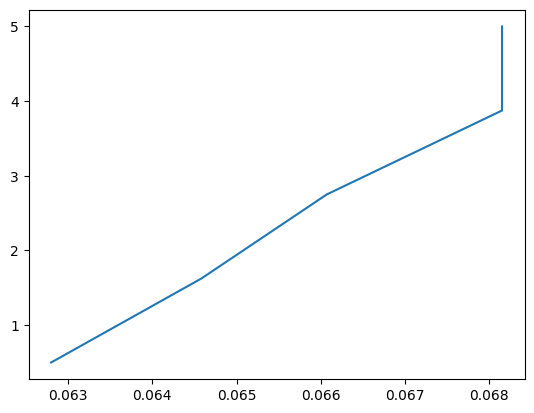

In [18]:
data_path = Path("./resources_lab5")
ff = scipy.io.loadmat(data_path / "Freq_Phase.mat")
freqs_all = ff.get('freqs').squeeze()
selected_idx = [0,1,2,3,4,5,6,7,16,17,18,19,20,21,22,23]
freqs_selected = freqs_all[selected_idx]
window_size = np.linspace(0.5, 5.0, 5)
sfreq = 250

def fft_subject_file(subject_idx, window_size_s=2.0, ICA_removal=True):
    n_samples = int(window_size_s * sfreq)
    fn = data_path / f"S{subject_idx}.mat"

    montage = mne.channels.read_custom_montage(data_path / "64-channels.loc")
    ch_names = montage.ch_names
    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types="eeg")

    mat = scipy.io.loadmat(fn)
    data = mat["data"]
    epochs_array = data.reshape(data.shape[0], data.shape[1], data.shape[2]*data.shape[3], order="F")
    epochs_array = np.swapaxes(epochs_array, 0, -1)
    epochs_array = np.swapaxes(epochs_array, 1, 2)

    epochs = mne.EpochsArray(epochs_array, info, tmin=0)
    epochs = epochs.filter(0.5, 45, verbose=False)

    if ICA_removal:
        ica = ICA(n_components=15, max_iter="auto", random_state=97)
        ica.fit(epochs)
        ica.exclude = [0]
        epochs = ica.apply(epochs.copy())

    freqs_true_all = np.tile(freqs_all, 6) 
    mask = np.isin(freqs_true_all, freqs_selected)
    epochs = epochs[mask]
    true_freqs = freqs_true_all[mask]

    X = epochs.get_data()
    n_epochs, n_channels, n_times = X.shape

    pred_freqs = []
    for ep in range(n_epochs):
        epoch = X[ep]
        segment = epoch[:, -n_samples:]
        window = np.hamming(n_samples)
        segment = segment * window[np.newaxis, :]

        fft_vals = np.fft.rfft(segment, axis=1)
        fft_freqs = np.fft.rfftfreq(n_samples, 1/sfreq)

        power = np.abs(fft_vals)
        spec = power.mean(axis=0)

        idx = np.argmax(spec)
        pred_f = fft_freqs[idx]

        nearest_idx = np.argmin(np.abs(freqs_selected - pred_f))
        pred_freqs.append(freqs_selected[nearest_idx])

    pred_freqs = np.array(pred_freqs)
    accuracy = np.mean(pred_freqs == true_freqs)
    print(f"Subject {subject_idx} FFT accuracy (window={window_size_s}s): {accuracy:.3f}")
    return true_freqs, pred_freqs, fft_freqs, spec

a_val = np.array([])
for window in window_size:
    avg_accuracy = np.array([])
    for i in range(1, 36):
        true_f, pred_f, f_axis, example_spec = fft_subject_file(i, window_size_s=window, ICA_removal=True)
        accuracy = np.mean(pred_f == true_f)
        avg_accuracy = np.append(avg_accuracy, accuracy)
    a_val = np.append(a_val, np.mean(avg_accuracy))

plt.plot(a_val, window_size)
plt.show()

CCA

Fitting ICA to data using 64 channels (please be patient, this may take a while)
Fitting ICA to data using 64 channels (please be patient, this may take a while)
Fitting ICA to data using 64 channels (please be patient, this may take a while)
Fitting ICA to data using 64 channels (please be patient, this may take a while)
Fitting ICA to data using 64 channels (please be patient, this may take a while)
Fitting ICA to data using 64 channels (please be patient, this may take a while)
Fitting ICA to data using 64 channels (please be patient, this may take a while)
Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 15 components
Selecting by number: 15 components
Selecting by number: 15 components
Selecting by number: 15 components
Selecting by number: 15 components
Selecting by number: 15 components
Selecting by number: 15 components
Selecting by number: 15 components
Fitting ICA took 20.1s.
Applying ICA to Epochs instance
    Transforming

/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 02: window=1.6s → acc=0.240
Subject 04: window=1.6s → acc=0.510
Subject 03: window=1.6s → acc=0.698
Subject 06: window=1.6s → acc=0.844
Subject 08: window=1.6s → acc=0.615
Subject 05: window=1.6s → acc=0.510
Subject 01: window=1.6s → acc=0.375
Subject 07: window=1.6s → acc=0.385


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 16: window=1.6s → acc=0.083
Subject 09: window=1.6s → acc=0.365
Subject 14: window=1.6s → acc=0.365
Subject 10: window=1.6s → acc=0.260
Subject 12: window=1.6s → acc=0.635
Subject 15: window=1.6s → acc=0.542
Subject 13: window=1.6s → acc=0.448
Subject 11: window=1.6s → acc=0.312
Subject 18: window=1.6s → acc=0.281
Subject 17: window=1.6s → acc=0.240
Subject 20: window=1.6s → acc=0.396
Subject 19: window=1.6s → acc=0.188
Subject 21: window=1.6s → acc=0.115
Subject 22: window=1.6s → acc=0.354


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 24: window=1.6s → acc=0.135
Subject 23: window=1.6s → acc=0.365


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 25: window=1.6s → acc=0.823
Subject 26: window=1.6s → acc=0.938
Subject 27: window=1.6s → acc=0.302
Subject 28: window=1.6s → acc=0.260
Subject 32: window=1.6s → acc=0.562
Subject 29: window=1.6s → acc=0.125
Subject 30: window=1.6s → acc=0.688
Subject 31: window=1.6s → acc=0.958


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 33: window=1.6s → acc=0.135
Subject 34: window=1.6s → acc=0.760
Subject 35: window=1.6s → acc=0.906


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 02: window=2.8s → acc=0.688
Subject 03: window=2.8s → acc=0.990
Subject 06: window=2.8s → acc=0.979
Subject 08: window=2.8s → acc=0.948
Subject 04: window=2.8s → acc=0.844
Subject 05: window=2.8s → acc=0.990
Subject 01: window=2.8s → acc=0.750


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 07: window=2.8s → acc=0.740
Subject 09: window=2.8s → acc=0.677
Subject 14: window=2.8s → acc=0.771
Subject 10: window=2.8s → acc=0.927
Subject 16: window=2.8s → acc=0.229
Subject 12: window=2.8s → acc=0.969
Subject 15: window=2.8s → acc=0.990
Subject 13: window=2.8s → acc=0.927


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 11: window=2.8s → acc=0.760


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 18: window=2.8s → acc=0.594
Subject 20: window=2.8s → acc=0.771
Subject 17: window=2.8s → acc=0.865
Subject 21: window=2.8s → acc=0.302
Subject 24: window=2.8s → acc=0.479
Subject 19: window=2.8s → acc=0.552
Subject 22: window=2.8s → acc=0.781
Subject 23: window=2.8s → acc=0.719
Subject 25: window=2.8s → acc=1.000
Subject 27: window=2.8s → acc=0.656
Subject 26: window=2.8s → acc=0.979
Subject 28: window=2.8s → acc=0.573
Subject 32: window=2.8s → acc=0.938
Subject 29: window=2.8s → acc=0.406
Subject 30: window=2.8s → acc=0.948
Subject 31: window=2.8s → acc=0.990
Subject 33: window=2.8s → acc=0.312
Subject 34: window=2.8s → acc=1.000
Subject 35: window=2.8s → acc=1.000


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 02: window=3.9s → acc=0.896
Subject 08: window=3.9s → acc=0.979
Subject 03: window=3.9s → acc=1.000
Subject 05: window=3.9s → acc=1.000
Subject 04: window=3.9s → acc=0.948
Subject 06: window=3.9s → acc=0.990
Subject 01: window=3.9s → acc=0.875
Subject 07: window=3.9s → acc=0.833


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 09: window=3.9s → acc=0.823
Subject 16: window=3.9s → acc=0.417
Subject 14: window=3.9s → acc=0.927
Subject 10: window=3.9s → acc=0.990
Subject 12: window=3.9s → acc=0.990
Subject 15: window=3.9s → acc=1.000
Subject 13: window=3.9s → acc=0.969
Subject 11: window=3.9s → acc=0.885


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 18: window=3.9s → acc=0.625
Subject 17: window=3.9s → acc=0.969
Subject 20: window=3.9s → acc=0.906
Subject 19: window=3.9s → acc=0.792
Subject 21: window=3.9s → acc=0.479
Subject 24: window=3.9s → acc=0.740
Subject 22: window=3.9s → acc=0.896
Subject 23: window=3.9s → acc=0.906


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 25: window=3.9s → acc=1.000
Subject 27: window=3.9s → acc=0.854
Subject 26: window=3.9s → acc=1.000
Subject 28: window=3.9s → acc=0.740
Subject 29: window=3.9s → acc=0.677
Subject 32: window=3.9s → acc=0.990
Subject 30: window=3.9s → acc=0.990
Subject 31: window=3.9s → acc=1.000


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 33: window=3.9s → acc=0.375
Subject 34: window=3.9s → acc=1.000
Subject 35: window=3.9s → acc=1.000
Subject 02: window=5.0s → acc=0.958
Subject 03: window=5.0s → acc=1.000
Subject 08: window=5.0s → acc=1.000
Subject 06: window=5.0s → acc=0.990
Subject 05: window=5.0s → acc=1.000
Subject 04: window=5.0s → acc=0.979
Subject 01: window=5.0s → acc=0.927
Subject 07: window=5.0s → acc=0.896


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 09: window=5.0s → acc=0.875
Subject 16: window=5.0s → acc=0.573
Subject 14: window=5.0s → acc=1.000
Subject 10: window=5.0s → acc=0.990
Subject 12: window=5.0s → acc=1.000
Subject 15: window=5.0s → acc=1.000
Subject 13: window=5.0s → acc=0.979
Subject 11: window=5.0s → acc=0.969


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 18: window=5.0s → acc=0.698


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 17: window=5.0s → acc=0.958
Subject 21: window=5.0s → acc=0.708
Subject 20: window=5.0s → acc=0.990
Subject 24: window=5.0s → acc=0.885
Subject 19: window=5.0s → acc=0.885
Subject 22: window=5.0s → acc=0.927
Subject 23: window=5.0s → acc=0.958


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 25: window=5.0s → acc=1.000
Subject 26: window=5.0s → acc=1.000
Subject 27: window=5.0s → acc=0.927
Subject 28: window=5.0s → acc=0.844
Subject 32: window=5.0s → acc=1.000
Subject 30: window=5.0s → acc=0.990
Subject 29: window=5.0s → acc=0.750
Subject 31: window=5.0s → acc=1.000


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 33: window=5.0s → acc=0.365
Subject 34: window=5.0s → acc=1.000
Subject 35: window=5.0s → acc=1.000


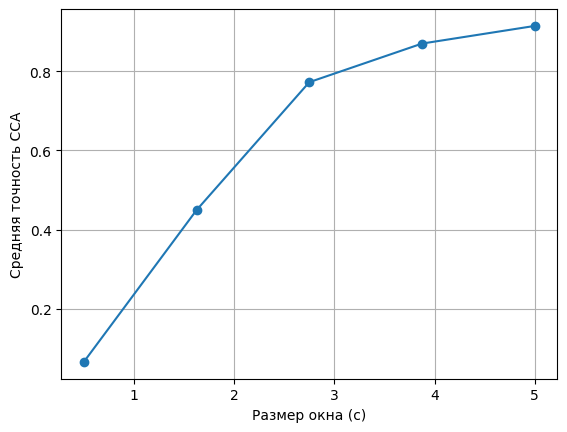

In [ ]:
from joblib import Parallel, delayed
import os

data_path = Path("./resources_lab5")
ff = scipy.io.loadmat(data_path / "Freq_Phase.mat")
freqs_all = ff.get("freqs").squeeze()
selected_idx = [0, 1, 2, 3, 4, 5, 6, 7, 16, 17, 18, 19, 20, 21, 22, 23]
freqs_selected = freqs_all[selected_idx]
sfreq = 250


def generate_reference_signals(freq, n_samples, n_harmonics=3, sfreq=250):
    t = np.arange(0, n_samples) / sfreq
    ref = []
    for h in range(1, n_harmonics + 1):
        ref.append(np.sin(2 * np.pi * h * freq * t))
        ref.append(np.cos(2 * np.pi * h * freq * t))
    return np.array(ref)


def preprocess_subject(subject_idx, ICA_removal=True):
    save_file = data_path / f"preprocessed_S{subject_idx}.npy"
    if os.path.exists(save_file):
        return np.load(save_file)

    fn = data_path / f"S{subject_idx}.mat"
    montage = mne.channels.read_custom_montage(data_path / "64-channels.loc")
    ch_names = montage.ch_names
    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types="eeg")

    mat = scipy.io.loadmat(fn)
    data = mat["data"]
    reps, n_freqs, n_times, n_ch = data.shape
    epochs_array = np.transpose(data, (3, 2, 0, 1)).reshape(-1, 64, 1500)

    epochs = mne.EpochsArray(epochs_array, info, tmin=0, verbose="ERROR")
    epochs = epochs.filter(0.5, 45, verbose="ERROR")

    if ICA_removal:
        ica = mne.preprocessing.ICA(n_components=15, max_iter="auto", random_state=97)
        ica.fit(epochs)
        ica.exclude = [0]
        epochs = ica.apply(epochs.copy())

    np.save(save_file, epochs.get_data())
    return epochs.get_data()


def cca_subject_file(subject_idx, window_size_s=2.0):
    X = preprocess_subject(subject_idx)
    n_samples = int(window_size_s * sfreq)

    freqs_true_all = np.tile(freqs_all, 6)
    mask = np.isin(freqs_true_all, freqs_selected)
    X = X[mask]
    true_freqs = freqs_true_all[mask]

    refs = {f: generate_reference_signals(f, n_samples, 3, sfreq) for f in freqs_selected}

    cca = CCA(n_components=2)
    pred_freqs = []
    for ep in range(X.shape[0]):
        epoch = X[ep, :, -n_samples:]
        epoch -= epoch.mean(axis=1, keepdims=True)
        corr_list = []
        for f in freqs_selected:
            Y_ref = refs[f]
            cca.fit(epoch.T, Y_ref.T)
            X_c, Y_c = cca.transform(epoch.T, Y_ref.T)
            corr_list.append(np.corrcoef(X_c[:, 0], Y_c[:, 0])[0, 1])
        pred_freqs.append(freqs_selected[np.argmax(corr_list)])

    acc = np.mean(np.array(pred_freqs) == true_freqs)
    print(f"Subject {subject_idx:02d}: window={window_size_s:.1f}s → acc={acc:.3f}")
    return acc


window_sizes = np.linspace(0.5, 5.0, 5)
a_val = []

for window in window_sizes:
    acc_all = Parallel(n_jobs=-1, backend="loky")(
        delayed(cca_subject_file)(subj, window_size_s=window) for subj in range(1, 36)
    )
    a_val.append(np.mean(acc_all))

plt.plot(window_sizes, a_val, marker="o")
plt.xlabel("Размер окна (с)")
plt.ylabel("Средняя точность CCA")
plt.grid(True)
plt.show()


FBCCA

/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 06 FBCCA acc (window=0.5s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 04 FBCCA acc (window=0.5s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 03 FBCCA acc (window=0.5s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 05 FBCCA acc (window=0.5s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 02 FBCCA acc (window=0.5s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 08 FBCCA acc (window=0.5s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 01 FBCCA acc (window=0.5s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 07 FBCCA acc (window=0.5s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 09 FBCCA acc (window=0.5s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 12 FBCCA acc (window=0.5s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 10 FBCCA acc (window=0.5s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 11 FBCCA acc (window=0.5s): 0.013


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 13 FBCCA acc (window=0.5s): 0.025
Subject 14 FBCCA acc (window=0.5s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 16 FBCCA acc (window=0.5s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 15 FBCCA acc (window=0.5s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 17 FBCCA acc (window=0.5s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 19 FBCCA acc (window=0.5s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 18 FBCCA acc (window=0.5s): 0.050


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 20 FBCCA acc (window=0.5s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 24 FBCCA acc (window=0.5s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 23 FBCCA acc (window=0.5s): 0.025
Subject 22 FBCCA acc (window=0.5s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 21 FBCCA acc (window=0.5s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 25 FBCCA acc (window=0.5s): 0.008


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 26 FBCCA acc (window=0.5s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 27 FBCCA acc (window=0.5s): 0.008


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 29 FBCCA acc (window=0.5s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 28 FBCCA acc (window=0.5s): 0.008


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 32 FBCCA acc (window=0.5s): 0.046


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 30 FBCCA acc (window=0.5s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 31 FBCCA acc (window=0.5s): 0.013


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 33 FBCCA acc (window=0.5s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 34 FBCCA acc (window=0.5s): 0.008


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 35 FBCCA acc (window=0.5s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 08 FBCCA acc (window=1.6s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 07 FBCCA acc (window=1.6s): 0.013


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 02 FBCCA acc (window=1.6s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 05 FBCCA acc (window=1.6s): 0.037
Subject 06 FBCCA acc (window=1.6s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 03 FBCCA acc (window=1.6s): 0.017
Subject 01 FBCCA acc (window=1.6s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 04 FBCCA acc (window=1.6s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 09 FBCCA acc (window=1.6s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 12 FBCCA acc (window=1.6s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 11 FBCCA acc (window=1.6s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 10 FBCCA acc (window=1.6s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 13 FBCCA acc (window=1.6s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 15 FBCCA acc (window=1.6s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 14 FBCCA acc (window=1.6s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 16 FBCCA acc (window=1.6s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 18 FBCCA acc (window=1.6s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 17 FBCCA acc (window=1.6s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 19 FBCCA acc (window=1.6s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 20 FBCCA acc (window=1.6s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 22 FBCCA acc (window=1.6s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 23 FBCCA acc (window=1.6s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 24 FBCCA acc (window=1.6s): 0.025
Subject 21 FBCCA acc (window=1.6s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 25 FBCCA acc (window=1.6s): 0.054


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 26 FBCCA acc (window=1.6s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 27 FBCCA acc (window=1.6s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 28 FBCCA acc (window=1.6s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 29 FBCCA acc (window=1.6s): 0.017


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 31 FBCCA acc (window=1.6s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 30 FBCCA acc (window=1.6s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 32 FBCCA acc (window=1.6s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 33 FBCCA acc (window=1.6s): 0.013


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 34 FBCCA acc (window=1.6s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 35 FBCCA acc (window=1.6s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 03 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 06 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 02 FBCCA acc (window=2.8s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 08 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 01 FBCCA acc (window=2.8s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 05 FBCCA acc (window=2.8s): 0.025
Subject 04 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 07 FBCCA acc (window=2.8s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 12 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 10 FBCCA acc (window=2.8s): 0.025
Subject 09 FBCCA acc (window=2.8s): 0.021


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 11 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 14 FBCCA acc (window=2.8s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 16 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 13 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 15 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 18 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 20 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 19 FBCCA acc (window=2.8s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 17 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 21 FBCCA acc (window=2.8s): 0.025
Subject 22 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 23 FBCCA acc (window=2.8s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 24 FBCCA acc (window=2.8s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 26 FBCCA acc (window=2.8s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 25 FBCCA acc (window=2.8s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 27 FBCCA acc (window=2.8s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 31 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 28 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 30 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 32 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 29 FBCCA acc (window=2.8s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 33 FBCCA acc (window=2.8s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 34 FBCCA acc (window=2.8s): 0.025
Subject 35 FBCCA acc (window=2.8s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 02 FBCCA acc (window=3.9s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 06 FBCCA acc (window=3.9s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 04 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 08 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 03 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 07 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 01 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 05 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 12 FBCCA acc (window=3.9s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 09 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 11 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 10 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 13 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 14 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 16 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 15 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 18 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 17 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 22 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 20 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 19 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 21 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 24 FBCCA acc (window=3.9s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 23 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 25 FBCCA acc (window=3.9s): 0.033


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 26 FBCCA acc (window=3.9s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 27 FBCCA acc (window=3.9s): 0.025
Subject 28 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 30 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 29 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 32 FBCCA acc (window=3.9s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 31 FBCCA acc (window=3.9s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 34 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 33 FBCCA acc (window=3.9s): 0.025


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 35 FBCCA acc (window=3.9s): 0.029


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 03 FBCCA acc (window=5.0s): 0.050
Subject 06 FBCCA acc (window=5.0s): 0.050
Subject 07 FBCCA acc (window=5.0s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 04 FBCCA acc (window=5.0s): 0.054
Subject 01 FBCCA acc (window=5.0s): 0.050


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 08 FBCCA acc (window=5.0s): 0.046
Subject 02 FBCCA acc (window=5.0s): 0.050
Subject 05 FBCCA acc (window=5.0s): 0.054


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 09 FBCCA acc (window=5.0s): 0.042
Subject 12 FBCCA acc (window=5.0s): 0.050


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 13 FBCCA acc (window=5.0s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 11 FBCCA acc (window=5.0s): 0.029
Subject 10 FBCCA acc (window=5.0s): 0.037
Subject 15 FBCCA acc (window=5.0s): 0.033
Subject 14 FBCCA acc (window=5.0s): 0.037


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 16 FBCCA acc (window=5.0s): 0.046


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 17 FBCCA acc (window=5.0s): 0.037
Subject 19 FBCCA acc (window=5.0s): 0.033
Subject 20 FBCCA acc (window=5.0s): 0.042
Subject 21 FBCCA acc (window=5.0s): 0.046
Subject 18 FBCCA acc (window=5.0s): 0.029
Subject 22 FBCCA acc (window=5.0s): 0.046
Subject 23 FBCCA acc (window=5.0s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 24 FBCCA acc (window=5.0s): 0.046


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 26 FBCCA acc (window=5.0s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 25 FBCCA acc (window=5.0s): 0.046
Subject 28 FBCCA acc (window=5.0s): 0.042


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)


Subject 29 FBCCA acc (window=5.0s): 0.033
Subject 27 FBCCA acc (window=5.0s): 0.050
Subject 31 FBCCA acc (window=5.0s): 0.042
Subject 30 FBCCA acc (window=5.0s): 0.054
Subject 32 FBCCA acc (window=5.0s): 0.054


/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-packages/sklearn/cross_decomposition/_pls.py:104: ConvergenceWarning: Maximum number of iterations reached
  warnings.warn("Maximum number of iterations reached", ConvergenceWarning)
/Users/ivanguseff/Documents/Файлы/Магистратура/1 курс/1 семестр/ЦОС/Готовые лабы/DSP/venv/lib/python3.10/site-package

Subject 34 FBCCA acc (window=5.0s): 0.054
Subject 33 FBCCA acc (window=5.0s): 0.025
Subject 35 FBCCA acc (window=5.0s): 0.046


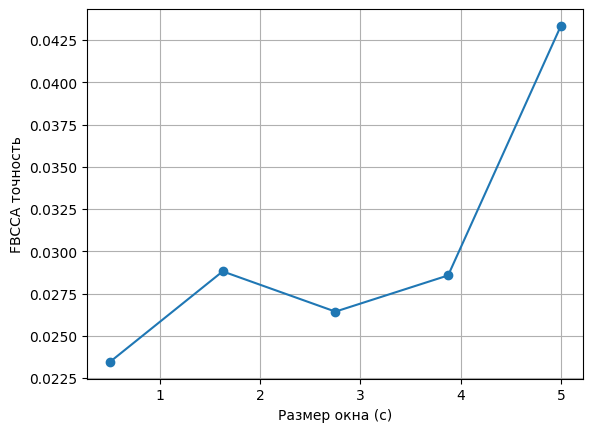

In [42]:
from joblib import Parallel, delayed
import os

data_path = Path("./resources_lab5")
sfreq = 250

ff = scipy.io.loadmat(data_path / "Freq_Phase.mat")
freqs_all = ff["freqs"].squeeze()
selected_idx = [0,1,2,3,4,5,6,7,16,17,18,19,20,21,22,23]
freqs_selected = freqs_all[selected_idx]


def bandpass_filter(data, low, high, fs, order=4):
    b, a = butter(order, [low / (fs / 2), high / (fs / 2)], btype='band')
    return filtfilt(b, a, data, axis=-1)

def generate_reference_signals(freq, fs, n_samples, n_harmonics=3):
    t = np.arange(n_samples) / fs
    ref = []
    for h in range(1, n_harmonics + 1):
        ref.append(np.sin(2 * np.pi * h * freq * t))
        ref.append(np.cos(2 * np.pi * h * freq * t))
    return np.array(ref)

def FBCCA(eeg_data, fs, freqs, refs, filters, weights):
    n_channels, n_samples = eeg_data.shape
    corr_scores = []

    for f in freqs:
        corr_f = 0
        for idx, (low, high) in enumerate(filters):
            filtered = bandpass_filter(eeg_data, low, high, fs)
            ref = refs[f]
            cca = CCA(n_components=1)
            cca.fit(filtered.T, ref.T)
            X_c, Y_c = cca.transform(filtered.T, ref.T)
            r = np.corrcoef(X_c[:, 0], Y_c[:, 0])[0, 1]
            corr_f += weights[idx] * (r ** 2)
        corr_scores.append(corr_f)

    pred_freq = freqs[np.argmax(corr_scores)]
    return pred_freq, corr_scores


def load_subject_data(subject_idx):
    cache_file = data_path / f"cached_S{subject_idx}.npy"
    if os.path.exists(cache_file):
        return np.load(cache_file)
    fn = data_path / f"S{subject_idx}.mat"
    mat = scipy.io.loadmat(fn)
    data = mat["data"]
    np.save(cache_file, data)
    return data


def fbcca_subject_file(subject_idx, window_size_s=2.0, n_filters=5, n_harmonics=3):
    data = load_subject_data(subject_idx)
    n_channels, n_times, n_freqs, n_reps = data.shape
    n_samples = int(window_size_s * sfreq)

    # Предсоздание фильтров и весов
    filter_bands = [(8 + 6 * i, 14 + 6 * i) for i in range(n_filters)]
    weights = np.array([i ** -1.25 + 0.25 for i in range(1, n_filters + 1)])
    # Предсоздание референсов
    refs = {f: generate_reference_signals(f, sfreq, n_samples, n_harmonics) for f in freqs_selected}

    pred_freqs = []
    true_freqs = []

    for rep in range(n_reps):
        for freq_idx, true_f in enumerate(freqs_all):
            epoch = data[:, -n_samples:, freq_idx, rep]
            pred_f, _ = FBCCA(epoch, sfreq, freqs_selected, refs, filter_bands, weights)
            pred_freqs.append(pred_f)
            true_freqs.append(true_f)

    pred_freqs = np.array(pred_freqs)
    true_freqs = np.array(true_freqs)
    accuracy = np.mean(pred_freqs == true_freqs)
    print(f"Subject {subject_idx:02d} FBCCA acc (window={window_size_s:.1f}s): {accuracy:.3f}")
    return accuracy


window_sizes = np.linspace(0.5, 5.0, 5)
a_val = []

for window in window_sizes:
    acc_all = Parallel(n_jobs=-1, backend="loky")(
        delayed(fbcca_subject_file)(subj, window_size_s=window)
        for subj in range(1, 36)
    )
    a_val.append(np.mean(acc_all))

plt.plot(window_sizes, a_val, marker="o")
plt.xlabel("Размер окна (с)")
plt.ylabel("FBCCA точность")
plt.grid(True)
plt.show()
